# **Filtering**

Imagine you have a digital photo, like one you took with your phone. Now, think about putting a special kind of lens or a colored gel in front of your camera after you've taken the picture. That's kind of what image filtering does, but it's all happening inside the computer with the digital data of the image.

In simple terms, image filtering is like applying a recipe to each pixel of your image, based on the colors of its nearby pixels. This recipe changes the color of that central pixel in a specific way.

Filtering images is at the core of image processing. The idea is to use a small image that travels across a larger image and does some operation on each sub-region of this larger image. In the simplest case, we can imagine that a small square travels across the image and computes the local mean of the pixels with which it overlaps.

References:
- https://github.com/guiwitz/PyImageCourse_beginner/blob/master/README.md
- https://coderzcolumn.com/tutorials/python/image-filtering-in-python-using-pillow
- https://pillow.readthedocs.io/en/stable/reference/ImageFilter.html

## Image Preparation

In [ ]:
# Import all required modules
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.pyplot as imshow
from PIL import Image, ImageOps, ImageFilter, ImageEnhance
from IPython.display import display, HTML
from google.colab import drive
drive.mount('/content/drive')
%matplotlib inline


Mounted at /content/drive


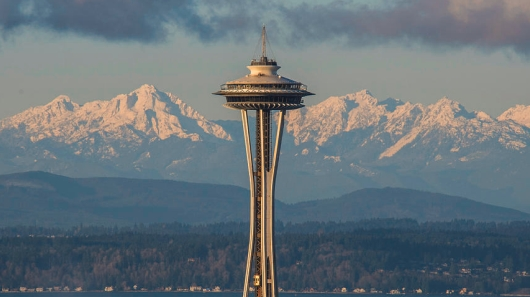

PIL.PngImagePlugin.PngImageFile

In [ ]:
base_path = '/content/drive/MyDrive/CS506/'
img = Image.open(base_path + 'seattle.jpg')
#plt.imshow(img)
display(img)
type(img)



pixel color at (0,0) is  (94, 111, 129)


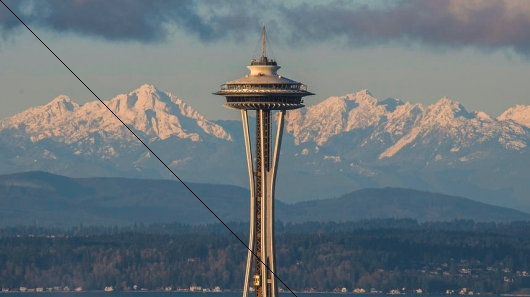

In [ ]:
# Draw black line on the image using putpixel()
pt = 0, 0
print("pixel color at (0,0) is ", img.getpixel(pt))
w, h = img.size
for x in range(h):
    img.putpixel((x, x), (0, 0, 0, 255))
display(img)

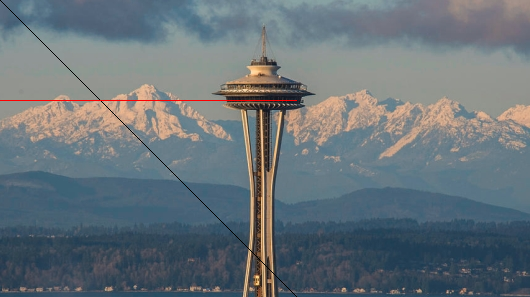

In [ ]:
# Draw horizontal line on a image using PixelAccess obj
imgpx = img.load() #Load image data based on sequence of data in a list [x,y]
imgpx[0, 0]
# you can also write the values to the image
for x in range(h):
    imgpx[x, 100] = (255, 0, 0)

display(img)

In [ ]:
from IPython.display import HTML
HTML(filename='/content/drive/MyDrive/CS506/convol_mean.html')
# Note: This was created by guiwitz. I am reusing his work to explain

Multiple properties of the *little travelling square* can change:
- the pixel values of the square can be anything. For example it's common to have a 2D gaussian for smoothing the image (see below)
- the size and shape of the square can change
- the operation done by the square does not have to be a simple multiplication-addition (convolution). It can also be another function like a median for example.

Filters can be applied to regular images, as well as to masks (binary images) and are often used to clean-up an image or to detect object.

- scikit-image implements most of these filters in ```skimage.filters``` and ```skimage.morphology``` and we are going to look at a few.
- PILLOW implements thes filters in ```PIL.ImageFilter```

**Linear filters**: A linear filter operates on an image by performing a linear combination of the pixel values in a local neighborhood of each pixel. This operation can be mathematically represented by a convolution between the image and a kernel (also known as a filter mask)
- **Mean or Averaging Filter:** Each pixel's value is replaced by the average of its neighboring pixel values. This is used for noise reduction and blurring. The kernel contains equal weights.
- **Gaussian Filter:** Uses a Gaussian function as the kernel, providing a weighted average where pixels closer to the center have higher weights. It's effective for smoothing while preserving edges better than a mean filter.
- **Box Filter:** Similar to the mean filter, but with a rectangular kernel where all pixels within the box are weighted equally.
- **Derivative Filters (e.g., Sobel, Prewitt):** Used for edge detection by approximating the image gradient. The kernels contain specific patterns of positive and negative weights to detect changes in intensity.
- **Sharpening Filters:** Enhance edges and details by emphasizing high-frequency components. Examples include the Laplacian filter and unsharp masking.

**Non-Linear filters**:A non-linear filter operates on an image where the output pixel's value is a non-linear function of the pixel values in its neighborhood. These filters do not follow the principle of superposition.
- **Median Filter:** Replaces each pixel's value with the median value of its neighbors. It is very effective at removing "salt-and-pepper" noise while preserving edges.
- **Min and Max Filters:** Replace each pixel's value with the minimum or maximum value in its neighborhood, respectively. These are used in morphological operations and for tasks like removing bright or dark spots.
- **Bilateral Filter:** A non-linear filter that smooths images while preserving edges by considering both the spatial proximity and the intensity difference between pixels.
- **Morphological Filters (e.g., Erosion, Dilation, Opening, Closing):** These filters modify the shape and size of objects in an image based on a structuring element. They are useful for noise removal, object segmentation, and shape analysis.
- **Adaptive Filters:** Filters whose behavior changes based on the local characteristics of the image. An example is the adaptive median filter, which adjusts the size of the neighborhood based on the noise density.


## Blurring effect

Let us start with empty image that has single pixel.


In [ ]:
# Create a single white dot on a black background using NumPy
single_dot = np.zeros((11, 11), dtype=np.uint8)  # Ensure the data type is suitable for image representation
single_dot[5, 5] = 255  # Set the center pixel to white (255 for 8-bit grayscale)
print("Original single dot:")
print(single_dot)



Original single dot:
[[  0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0 255   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0]]


In [ ]:
# Convert the NumPy array to a PIL Image
img_pil = Image.fromarray(single_dot)

# Apply the BLUR filter using ImageFilter.BLUR
blurred_img_pil = img_pil.filter(ImageFilter.BLUR)
boxblurred_img_pil = img_pil.filter(ImageFilter.BoxBlur(1.0))
# Convert the PIL Image back to a NumPy array for plotting
filtered = np.array(blurred_img_pil)
print("\nBlurred single dot (NumPy array):")
print(filtered)
print("\nBox Blurred single dot (NumPy array):")
print(np.array(boxblurred_img_pil))



Blurred single dot (NumPy array):
[[ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0 16 16 16 16 16  0  0  0]
 [ 0  0  0 16  0  0  0 16  0  0  0]
 [ 0  0  0 16  0  0  0 16  0  0  0]
 [ 0  0  0 16  0  0  0 16  0  0  0]
 [ 0  0  0 16 16 16 16 16  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]]

Box Blurred single dot (NumPy array):
[[ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 28 28 28  0  0  0  0]
 [ 0  0  0  0 28 28 28  0  0  0  0]
 [ 0  0  0  0 28 28 28  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]]


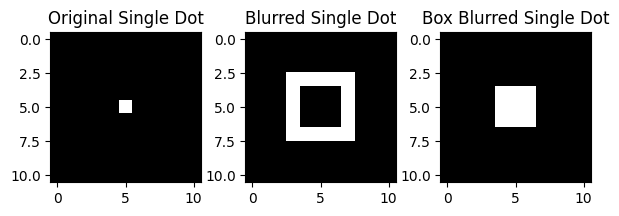

In [ ]:
# Displaying both images
plt.figure(figsize=(6, 4))
plt.subplot(1, 3, 1)
plt.imshow(single_dot, cmap='gray')
plt.title('Original Single Dot')
plt.subplot(1, 3, 2)
plt.imshow(filtered, cmap='gray')
plt.title('Blurred Single Dot')
plt.subplot(1, 3, 3)
plt.imshow(np.array(boxblurred_img_pil), cmap='gray')
plt.title('Box Blurred Single Dot')
plt.tight_layout()
plt.show()


In [ ]:
display(img_pil,blurred_img_pil,boxblurred_img_pil)

**What happened?**
The BLUR filter convolves below mentioned 5x5 kernel on the original image in order to generate a blurred image.
```
[[1, 1, 1, 1, 1,],
 [1, 0, 0, 0, 1,],
 [1, 0, 0, 0, 1,],
 [1, 0, 0, 0, 1,],
 [1, 1, 1, 1, 1,]]
```
The above kernel only takes all edge pixels of the kernel and all intermediate pixels will be ignored. This will result in making the image blur as we'll lose some data.


In [ ]:
# Defining  custom blur kernel (e.g., a simple averaging kernel)
kernel_size = 3
#blur_kernel = np.ones((kernel_size, kernel_size), dtype=np.float32) / (kernel_size * kernel_size)
blur_kernel = np.ones((kernel_size, kernel_size), dtype=np.float32) / (kernel_size * kernel_size)
#blur_kernel[1,1]=0
print("Custom Blur Kernel:")
print(blur_kernel)

Custom Blur Kernel:
[[0.11111111 0.11111111 0.11111111]
 [0.11111111 0.11111111 0.11111111]
 [0.11111111 0.11111111 0.11111111]]


In [ ]:
# Apply the convolution using scipy.ndimage.convolve
from scipy.ndimage import convolve
blurred_custom_kernel = convolve(single_dot, blur_kernel, mode='constant', cval=0.0)
print(blurred_custom_kernel)


[[ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 28 28 28  0  0  0  0]
 [ 0  0  0  0 28 28 28  0  0  0  0]
 [ 0  0  0  0 28 28 28  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0]]


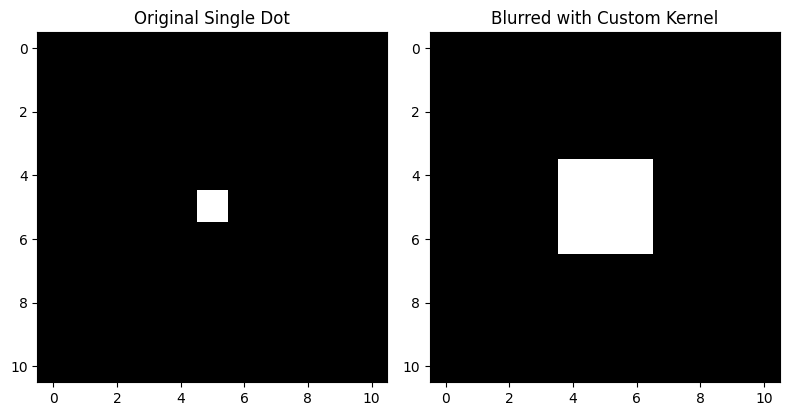

In [ ]:
# Display the original and blurred images
plt.figure(figsize=(8, 4))

plt.subplot(1, 2, 1)
plt.imshow(single_dot, cmap='gray')
plt.title('Original Single Dot')

plt.subplot(1, 2, 2)
plt.imshow(blurred_custom_kernel, cmap='gray')
plt.title('Blurred with Custom Kernel')

plt.tight_layout()
plt.show()

Refer https://pillow.readthedocs.io/en/stable/reference/ImageFilter.html for more information on filters.

From now onwards, We will apply all filters on our iconic image space needle.

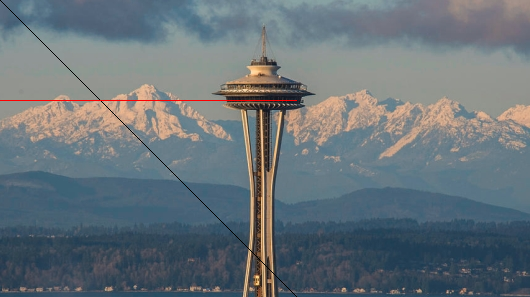

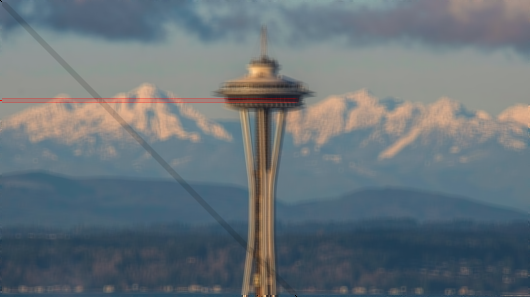

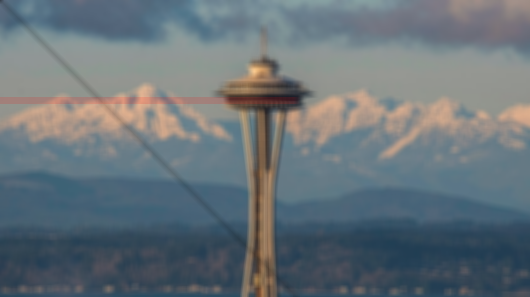

In [ ]:
imgb = img.filter(ImageFilter.BLUR)  # Applying filter BLUR
imgb1 = img.filter(ImageFilter.BoxBlur(3))
display(img, imgb,imgb1)

## SHARPEN Filter

**Sharpening** is a technique used to enhance the edges and details of an image, making them appear more defined and clear. It even increases the contrast between light and dark areas of the image in order to improve the features of an image. The SHARPEN filter in the Python Pillow library applies a sharpening effect to an image.

In the context of Python's Pillow library, image enhancement refers to adjusting the visual appearance of an image to improve its quality or highlight specific features. The ImageEnhance module in Pillow provides several classes for performing different types of enhancements:

*   **Brightness:** Adjusts the overall lightness or darkness of the image.
*   **Contrast:** Modifies the difference between light and dark areas, making details more or less prominent.
*   **Color:** Alters the intensity of colors in the image.
*   **Sharpness:** Enhances the edges and fine details, making the image appear crisper.

**How it Works:**

Each enhancement class in Pillow implements a common interface with an enhance() method.

This method takes a factor as an argument, which determines the degree of enhancement. A factor of 1.0 typically returns the original image, while values greater than 1.0 increase the effect and values less than 1.0 decrease it.

**General Kernel** used by this filter is shown below.
```
[[-2, -2, -2],
 [-2, 32, -2],
 [-2, -2, -2]]
 ```

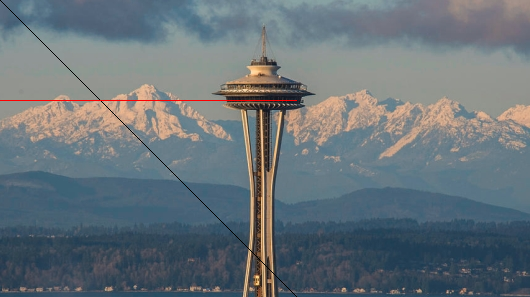

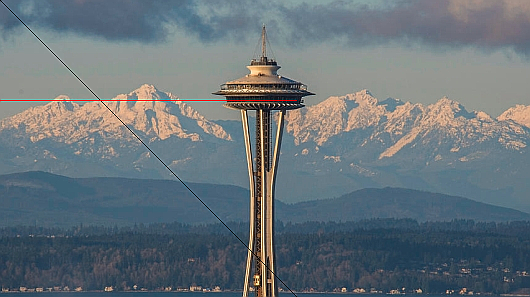

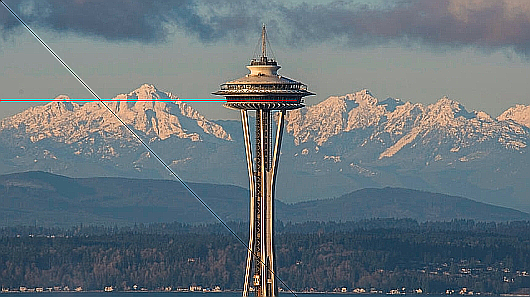

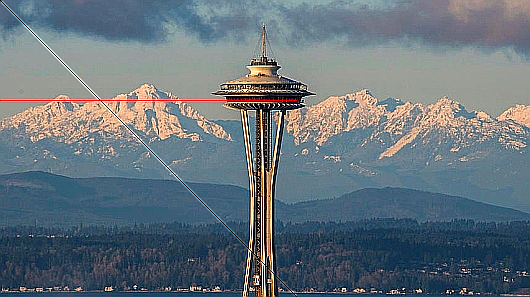

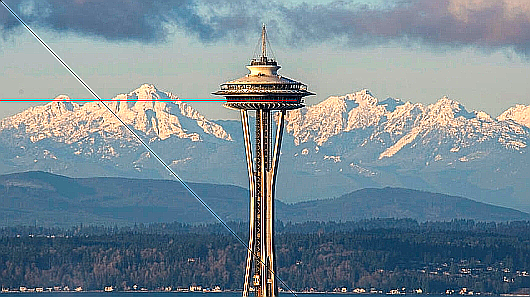

In [ ]:
imgs = img.filter(ImageFilter.SHARPEN)
imgs1 = imgs.filter(ImageFilter.SHARPEN)           # Applying SHARPEN filter twice to highlight edges
imgs2 = ImageEnhance.Contrast(imgs1).enhance(1.2)   # Applying contrast to create difference between light and dark areas by 1.2
imgs3 = ImageEnhance.Brightness(imgs2).enhance(1.2) # Increasing brightness by 1.2
#plt.imshow(imgs)
display(img, imgs, imgs1, imgs2, imgs3)

## SMOOTH Filter

The SMOOTH filter is used to reduce noise in data and apply the little blur. SMOOTH filter convolves the below-mentioned 3x3 kernel on our image in order to generate a smooth image.
```
[[1, 1, 1],
 [1, 5, 1],
 [1, 1, 1]]
 ```

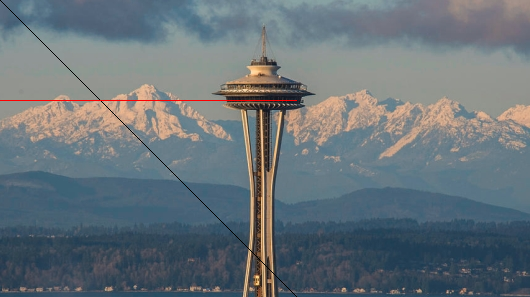

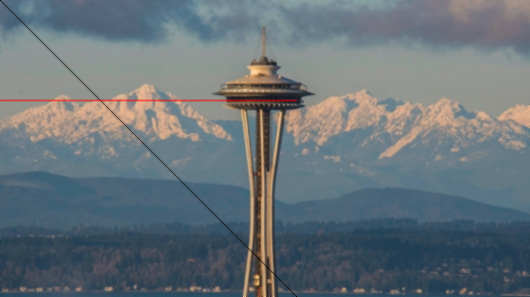

In [ ]:
img_smooth = img.filter(ImageFilter.SMOOTH)
display(img, img_smooth)

## Unsharp Mask

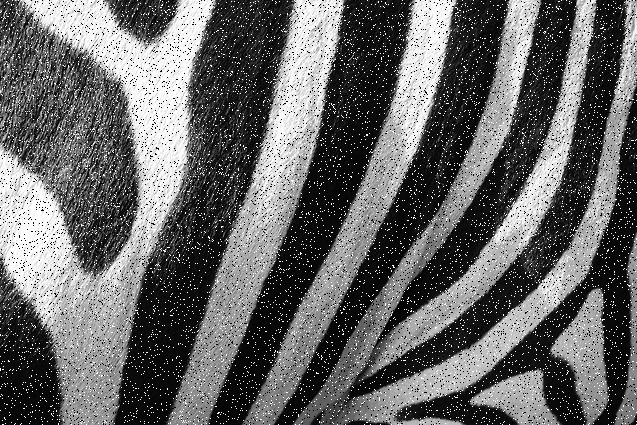

In [ ]:
img = Image.open(base_path + 'zebra.jpg')
display(img)

**What does Unsharp Masking do?**

Despite its name, Unsharp Masking actually sharpens an image. It works by:
Creating a blurred copy of the original image: This is done using a Gaussian blur, which smooths out the image details.

Subtracting the blurred image from the original: This creates a "mask" that highlights the edges and details in the original image.

Adding the mask back to the original image: This emphasizes the details, making the image appear sharper.

**Parameters of ImageFilter.UnsharpMask:**


*   radius: Controls the amount of blurring used to create the mask. A larger radius means more blurring, which can lead to a stronger sharpening effect.
*   percent: Controls the strength of the sharpening effect. A higher percentage results in a more pronounced sharpening.
*   threshold:Controls the minimum brightness change that will be sharpened. This helps to prevent noise from being amplified.

Various filters are explained at https://towardsdatascience.com/image-filters-in-python-26ee938e57d2






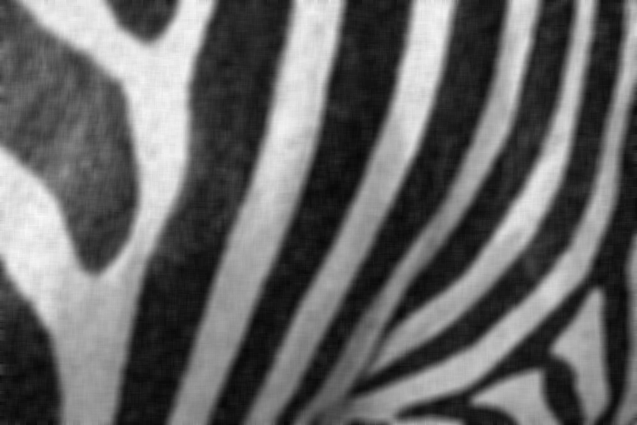

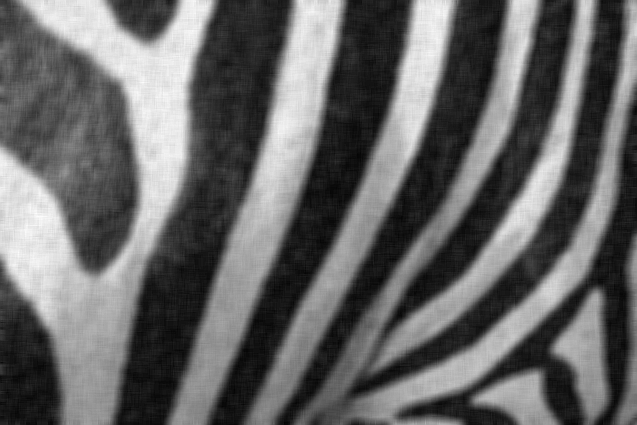

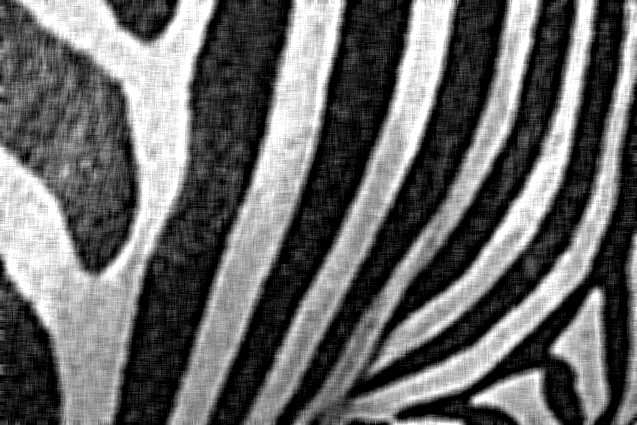

In [ ]:
# each pixel in the resulting image has a value equal to the average value of its
# neighboring pixels in the input image. It is a form of low-pass ("blurring")
# filter. A 3 by 3 box blur ("radius 1") can be written as matrix
# https://www.geeksforgeeks.org/box-blur-algorithm-with-python-implementation/
# PIL.ImageFilter.BoxBlur() Blurs the image by setting each pixel to the average value of the pixels in a square box extending radius pixels in each direction

imgb = img.filter(ImageFilter.BoxBlur(5)) # average smoothing
imgs = imgb.filter(ImageFilter.SHARPEN)

#imgs = imgs.filter(ImageFilter.SHARPEN)
# applies a Gaussian blur to a copy of the original image and then compares it
# to the original. If the difference is greater than a user-specified threshold
# setting, the images are (in effect) subtracted. (Radius,

imgus = imgs.filter(ImageFilter.UnsharpMask(5.0, 255, 1)) # radius=5, percent=255, threshold = 1
# plt.figure(figsize=(10,10))
# plt.imshow(imgus)
display(imgb,imgs,  imgus)

## Max and Min Filters

**What is Salt and Pepper noise ?**

It is found only in grayscale images (black and white image). As the name suggests salt (white) in pepper (black)–white spots in the dark regions or pepper (black) in salt (white)–black spots in the white regions. For more information, visit https://medium.com/@abhishekjainindore24/salt-and-pepper-noise-and-how-to-remove-it-in-machine-learning-

PIL.ImageFilter.MinFilter() method creates a min filter. Picks the lowest pixel value in a window with the given size.

PIL.ImageFilter.MaxFilter() method creates a max filter. Picks the largest pixel value in a window with the given size.

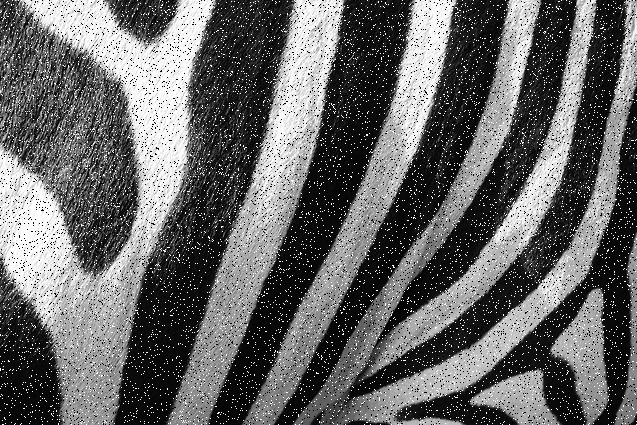

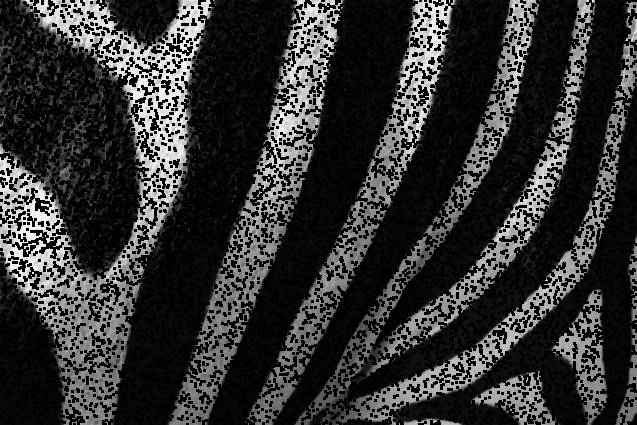

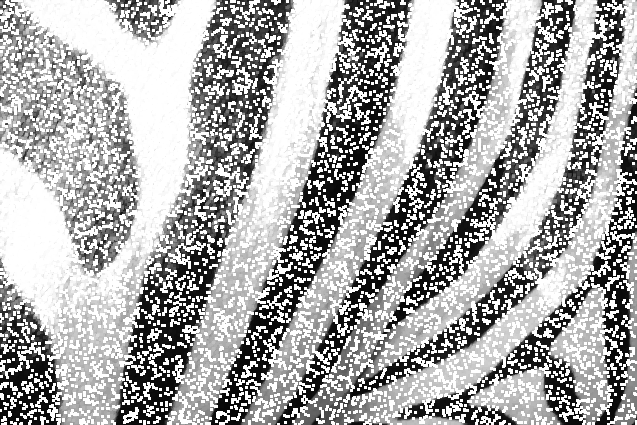

In [ ]:
# Let's try a min filter with radius = 3
# You will see the black spots that is because of the pepper noise
imgmin = img.filter(ImageFilter.MinFilter(3)) # location of pepper noise location MaxFilter location of salt noise
# Now if we try a max filter with radius = 3,
# you will see the white spots that is because of the salt noise
imgmax = img.filter(ImageFilter.MaxFilter(3))

# How about if we try first MinFilter(n) followed by MaxFilter(n+2 or 4)
# so that the black spots get replaced by MaxFilter that include the black spots.
#- imgmax = imgmin.filter(ImageFilter.MaxFilter(7))
#- imgmin = imgmax.filter(ImageFilter.GaussianBlur(2)) # gaussian window
#- imgmin = imgmin.filter(ImageFilter.UnsharpMask(5.0, 255, 1))
#- imgb = ImageEnhance.Brightness(imgmin).enhance(0.9)
#- imgc = ImageEnhance.Contrast(imgb).enhance(0.9)

#plt.figure(figsize=(10,10))
#plt.imshow(imgc)
display(img, imgmin, imgmax)



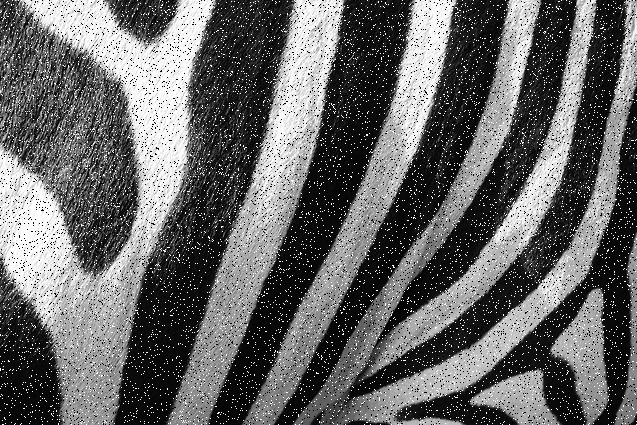

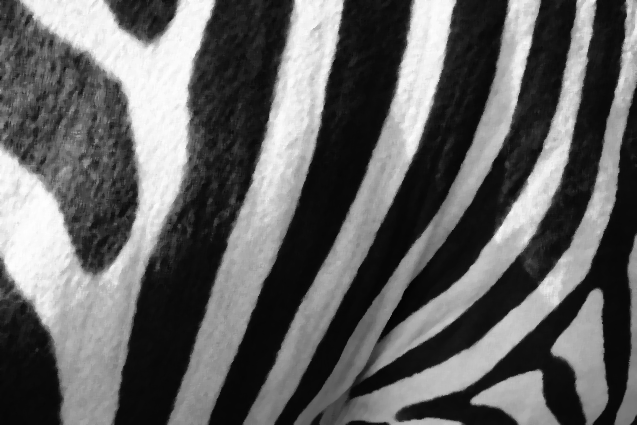

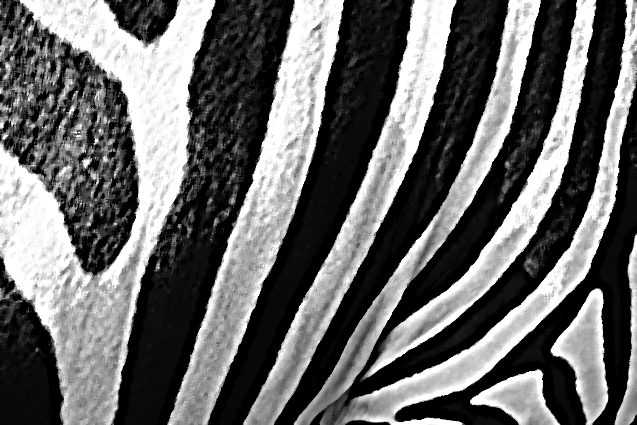

In [ ]:
# Sort the pixels, then pick the median value
imgm = img.filter(ImageFilter.MedianFilter(5))
#plt.figure(figsize=(10,10))

# Since the image has gotten brighter, we can make the image less bright
# by calling ImageEnhance module.
# enhance(factor): Factor 1.0 always returns a copy of the original image,
# lower factors mean less color (brightness, contrast, etc), and higher
# values more. There are no restrictions on this value.

imgu = imgm.filter(ImageFilter.UnsharpMask(5.0, 255, 1)) # aplying unsharpmax, brighness, contrast
imgme = ImageEnhance.Brightness(imgu).enhance(1)
imgc = ImageEnhance.Contrast(imgme).enhance(1)

#plt.imshow(imgc)
display(img, imgm, imgc)

## Applying all the learned skills

290 435


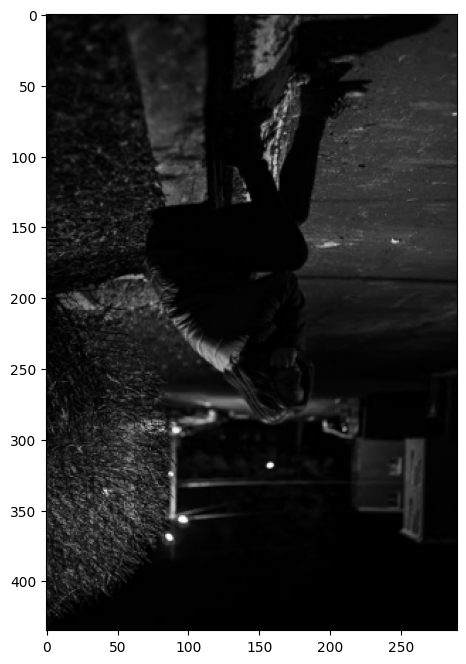

In [ ]:
# In this image, you will see very dark image with very little contrast nor graylevels as
# most of pixels are stored in lower range. As the histogram shows, most of pixels are in
# less than 50. (0=black, 256=white)
img = Image.open(base_path + 'lady.jpg')
# img = Image.open('input3.jpg')
# img = Image.open('input4.png')
# img = Image.open('eye.png')
plt.figure(figsize=(8,8))
plt.imshow(img)
x, y = img.size
print(x, y)

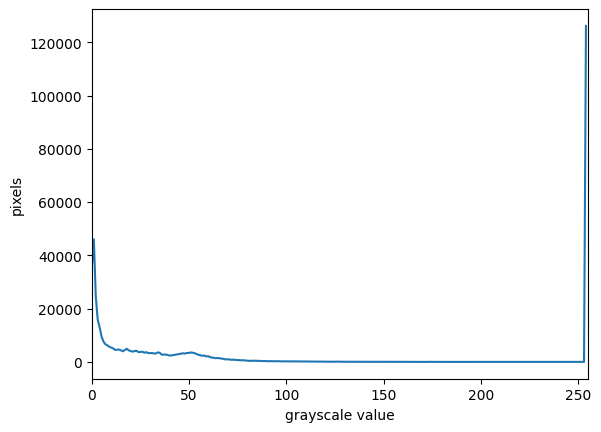

In [ ]:
import numpy as np
def hist(in_img):
    # Let's create a histogram
    # The parameter bins determines the histogram size, or the number of “bins” to use for the histogram.
    # We pass in 256 because we want to see # the pixel count for each of the 256 possible
    # values in the grayscale image.

    histogram, bin_edges = np.histogram(in_img, bins=256, range=(0, 255))
    plt.xlabel("grayscale value")
    plt.ylabel("pixels")
    plt.xlim([0.0, 255.0])  # <- named arguments do not work here
    plt.plot(bin_edges[0:-1], histogram)
    plt.show()
hist(img)

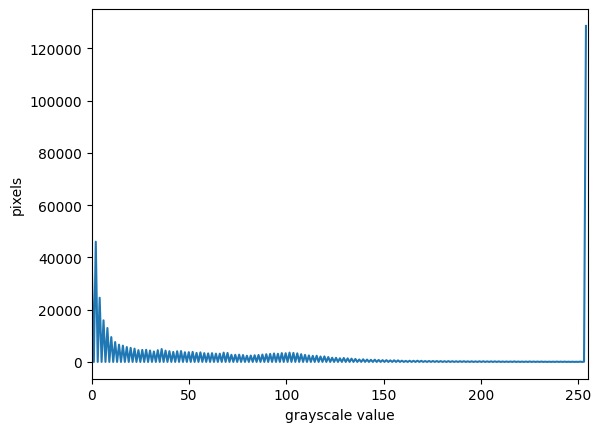

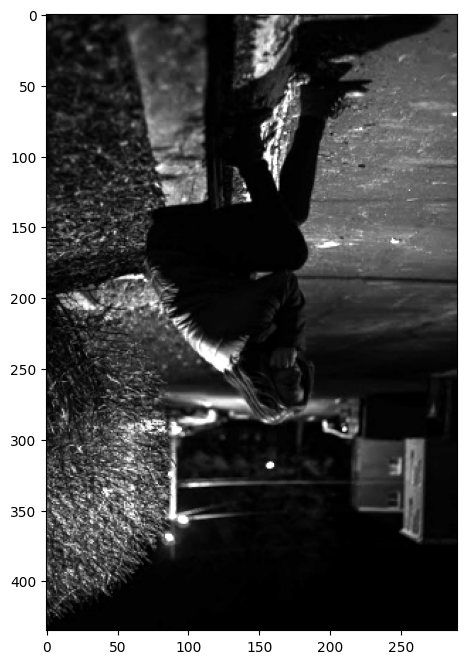

In [ ]:
# image appears to be too dark.
imgb = ImageEnhance.Brightness(img).enhance(2)
# simplying brightening won't work since most of pixels are stored as black.
# so, let's try to make the image less contrast using the Contrast
hist(imgb)
plt.figure(figsize=(8,8))
plt.imshow(imgb)


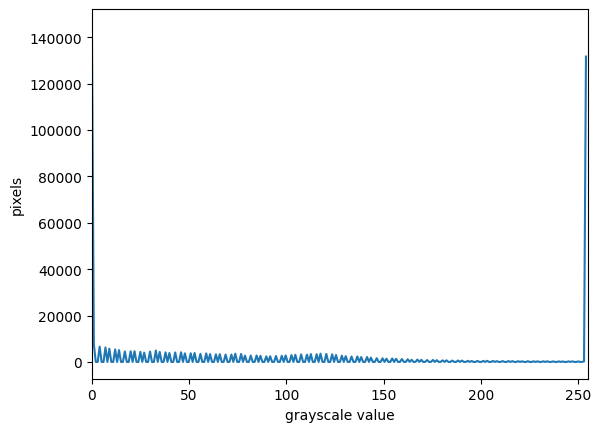

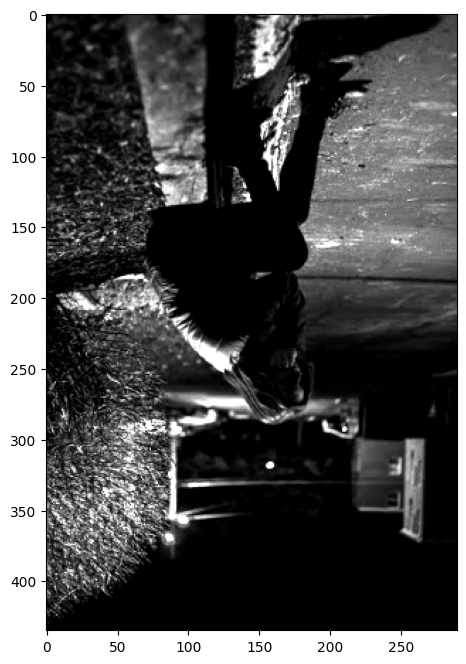

In [ ]:
# image appears to be too dark.
imgc = ImageEnhance.Brightness(img).enhance(2)  # shifts around black to white.
# move the pixels to 2 directions, both whites and blacks.
imgc = ImageEnhance.Contrast(imgc).enhance(1.3) # changes the range of lowest and highest (Make |_<->_| shape of histogram)

# simplying brightening won't work since most of pixels are stored as black.
# so, let's try to make the image less contrast using the Contrast
hist(imgc)
plt.figure(figsize=(8,8))
plt.imshow(imgc)


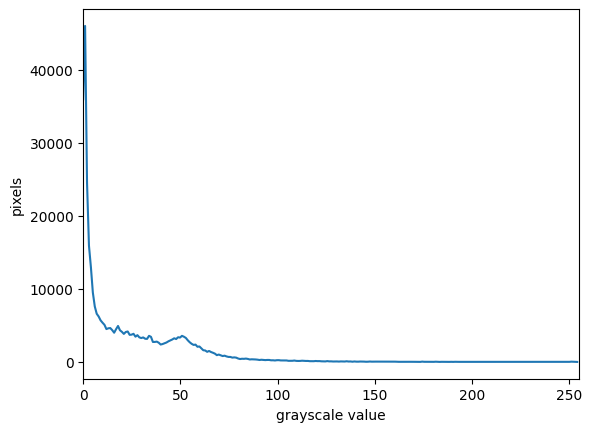

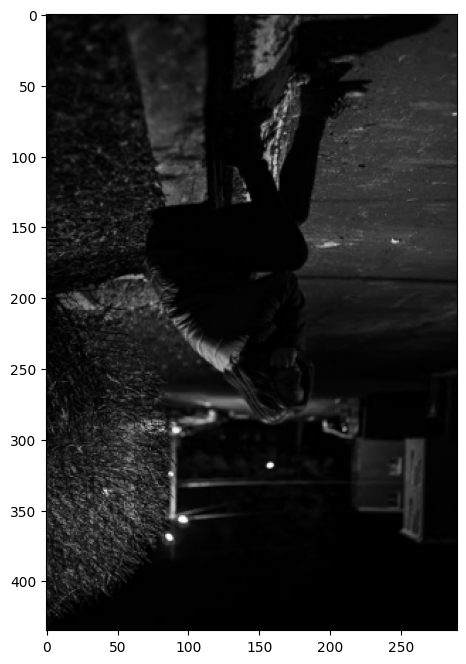

In [ ]:
img = img.convert('RGB')
hist(img)
plt.figure(figsize=(8,8))
plt.imshow(img)

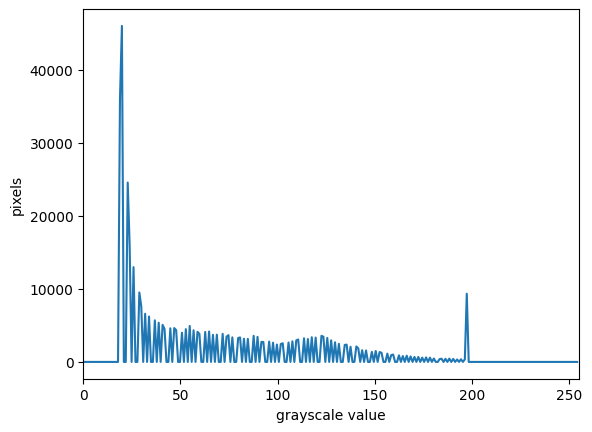

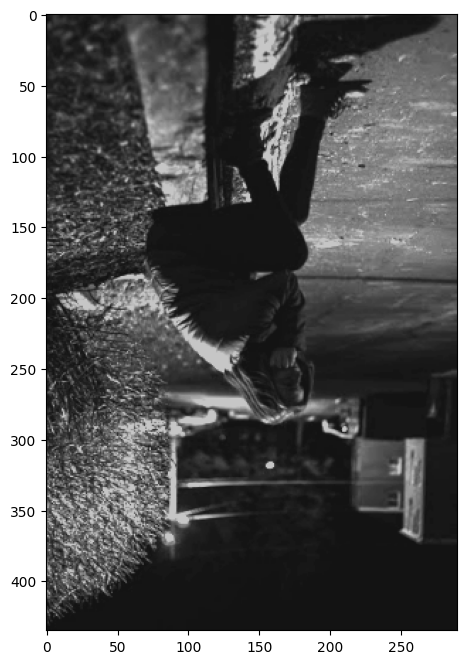

In [ ]:
# Let's try ImageOps modules where they have 2 relevant processing methods, (1) autocontrast and (2) equalize
# (1) autocontrast(image, cutoff=0, ignore=None)
# Maximize (normalize) image contrast. This function calculates a histogram of the input image, removes
# cutoff percent of the lightest and darkest pixels from the histogram, and remaps the image so that
# the darkest pixel becomes black (0), and the lightest becomes white (255).

imgac = ImageOps.autocontrast(img, 1) # discarding pixels from the both ends
imgb = ImageEnhance.Brightness(imgac).enhance(1.3)
imgc = ImageEnhance.Contrast(imgb).enhance(0.7)
hist(imgc)
plt.figure(figsize=(8,8))
plt.imshow(imgc)


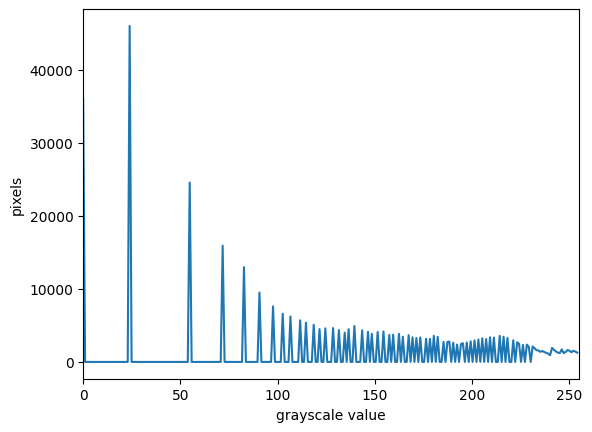

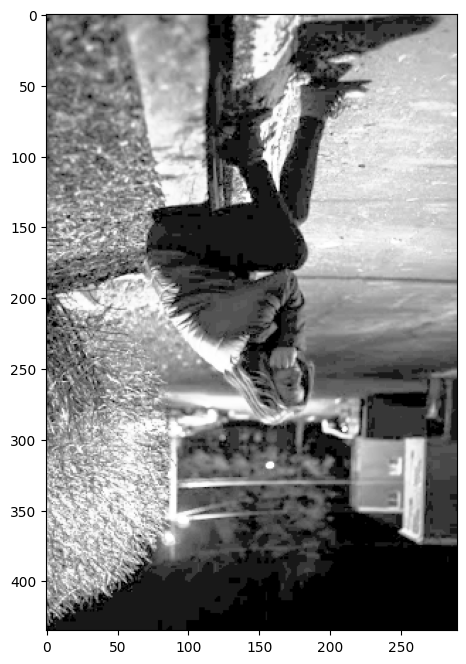

In [ ]:
# Let's try ImageOps modules where they have 2 relevant processing methods, (1) autocontrast and (2) equalize
# (2) equalize(image, cutoff=0, ignore=None)
#img = Image.open('lady.jpg')
#img = Image.open('input4.png')
#img = Image.open('eye.png')

imgh = ImageOps.equalize(img)
#imgh = ImageOps.autocontrast(imgh, 10) # discarding pixels from the both ends
#imgh = ImageEnhance.Brightness(imgh).enhance(0.3)
#imgh = ImageEnhance.Contrast(imgh).enhance(1)
#imgh = imgh.filter(ImageFilter.MedianFilter(3))
#imgh = imgh.filter(ImageFilter.UnsharpMask(2.0, 32, 1))

hist(imgh)
plt.figure(figsize=(8,8))
plt.imshow(img)
plt.imshow(imgh)
#display(img, imgh)